In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import seaborn as sns
import logging

import logging
import sys

def setup_logging(epoch_key, date_format='%d-%b-%y %H:%M:%S', format='%(asctime)s %(message)s'):
    animal, day, epoch = epoch_key
    log_filename = f"{animal}_{day:02d}_{epoch:02d}.log"

    logger = logging.getLogger()
    logger.setLevel(logging.INFO)
    formatter = logging.Formatter(fmt=format, datefmt=date_format)

    stdout_handler = logging.StreamHandler(sys.stdout)
    stdout_handler.setLevel(logging.INFO)
    stdout_handler.setFormatter(formatter)

    file_handler = logging.FileHandler(log_filename)
    file_handler.setLevel(logging.INFO)
    file_handler.setFormatter(formatter)

    logger.addHandler(file_handler)
    logger.addHandler(stdout_handler)

sns.set_context("talk")

In [3]:
epoch_key = 'Jaq', 3, 12

In [4]:
setup_logging(epoch_key)

In [5]:
from dask.distributed import Client

# for virga
client = Client(n_workers=28, threads_per_worker=2, processes=True)

client

Client Scheduler: tcp://127.0.0.1:45927 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 28 Cores: 56 Memory: 404.32 GB


In [6]:
from src.load_data import load_data


data = load_data(epoch_key,
                 position_to_linearize=['nose_x', 'nose_y'],
                 max_distance_from_well=5,
                 min_distance_traveled=30)

24-May-21 13:32:38 Loading position info...
24-May-21 13:33:23 Loading multiunit...
24-May-21 13:33:53 Loading spikes...
24-May-21 13:35:27 Finding ripple times...


In [7]:
continuous_transition_types = (
    [['random_walk', 'uniform'],
     ['uniform',     'uniform']])


classifier_parameters = {
    'movement_var': 6.0,
    'replay_speed': 1,
    'place_bin_size': 2.5,
    'continuous_transition_types': continuous_transition_types,
    'discrete_transition_diag': 0.968,
    'model_kwargs': {
        'bandwidth': np.array([20.0, 20.0, 20.0, 20.0, 8.0])}, 
}

In [ ]:
from replay_trajectory_classification import ClusterlessClassifier
from src.parameters import WTRACK_EDGE_ORDER, WTRACK_EDGE_SPACING, PROCESSED_DATA_DIR

from sklearn.model_selection import KFold
import os

state_names = ['Continuous', 'Fragmented']
cv = KFold()
results = []

for fold_ind, (train, test) in enumerate(cv.split(data["position_info"].index)):
    logging.info(f'Fitting Fold #{fold_ind + 1}...')
    classifier = ClusterlessClassifier(**classifier_parameters)
    classifier.fit(
        position=data["position_info"].iloc[train].linear_position,
        multiunits=data["multiunits"].isel(time=train),
        track_graph=data["track_graph"],
        edge_order=WTRACK_EDGE_ORDER,
        edge_spacing=WTRACK_EDGE_SPACING,
    )
    classifier.save_model(
        os.path.join(PROCESSED_DATA_DIR,
            f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_"
            f"clusterless_fold{fold_ind}_model.pkl")
    )

    logging.info('Predicting posterior...')
    results.append(
        classifier.predict(
            data["multiunits"].isel(time=test),
            time=data["position_info"].iloc[test].index / np.timedelta64(1, "s"),
            state_names=state_names
        )
    )
    
# concatenate results 
results = xr.concat(
    results, dim="time"
)

# save the results as .nc format. ncread matlab can read these
results.to_netcdf(
    os.path.join(PROCESSED_DATA_DIR,
   f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_clusterless_results.nc")
)
logging.info('Done...\n\n')

17-May-21 22:32:25 Fitting Fold #1...
17-May-21 22:32:26 Fitting initial conditions...
17-May-21 22:32:27 Fitting state transition...
17-May-21 22:32:27 Fitting multiunits...
17-May-21 22:32:33 Predicting posterior...


In [7]:
client.close()

In [12]:
import os
from src.parameters import PROCESSED_DATA_DIR
from replay_trajectory_classification import ClusterlessClassifier

results = xr.open_dataset(
    os.path.join(PROCESSED_DATA_DIR,
   f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_clusterless_results.nc"))

fold_ind = 4
classifier = ClusterlessClassifier.load_model(
    os.path.join(PROCESSED_DATA_DIR,
    f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_"
    f"clusterless_fold{fold_ind}_model.pkl")
)

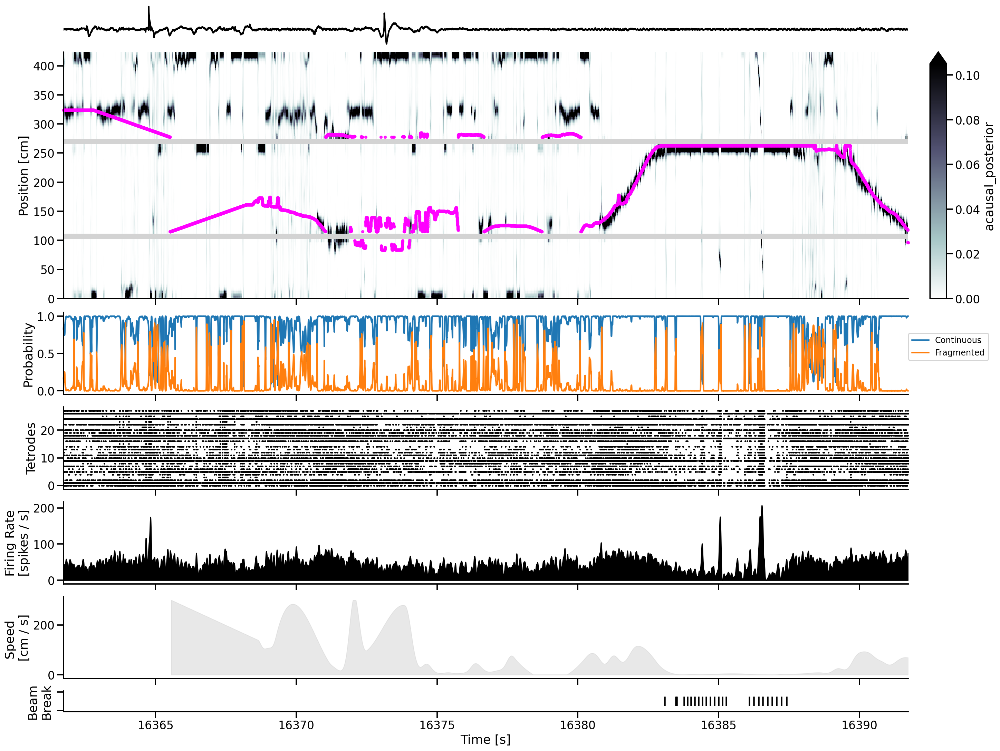

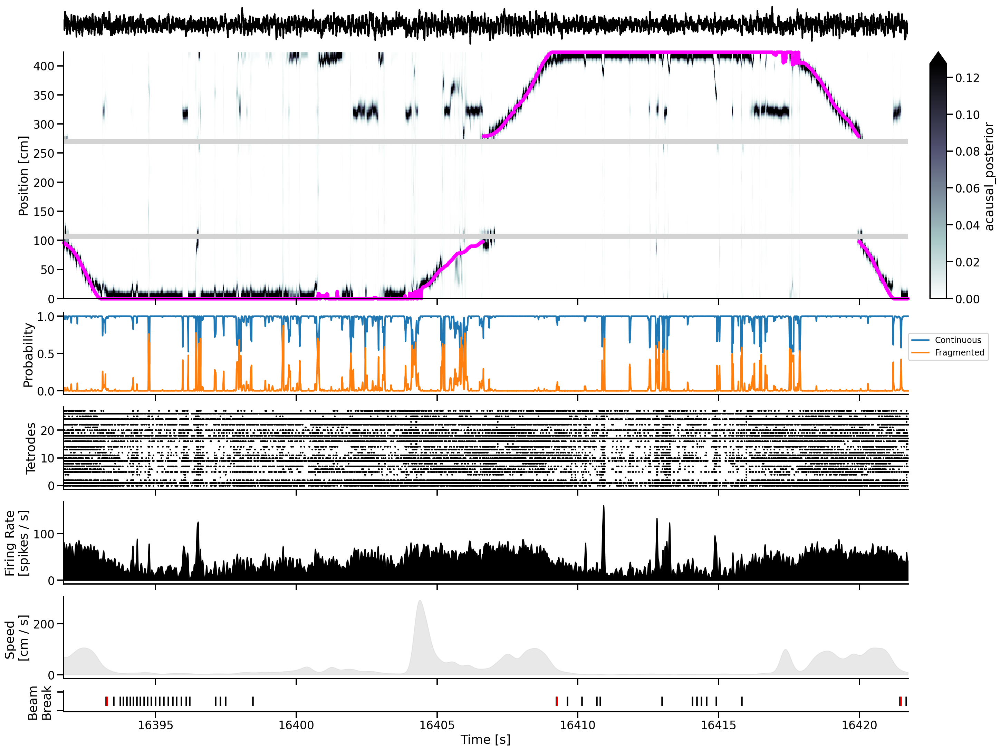

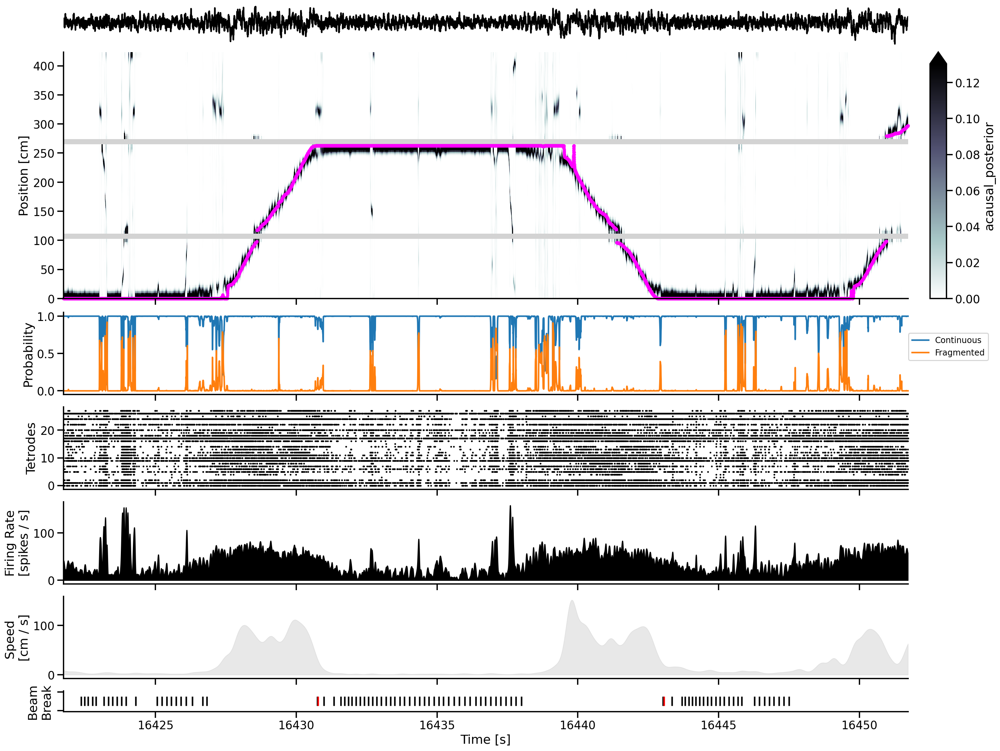

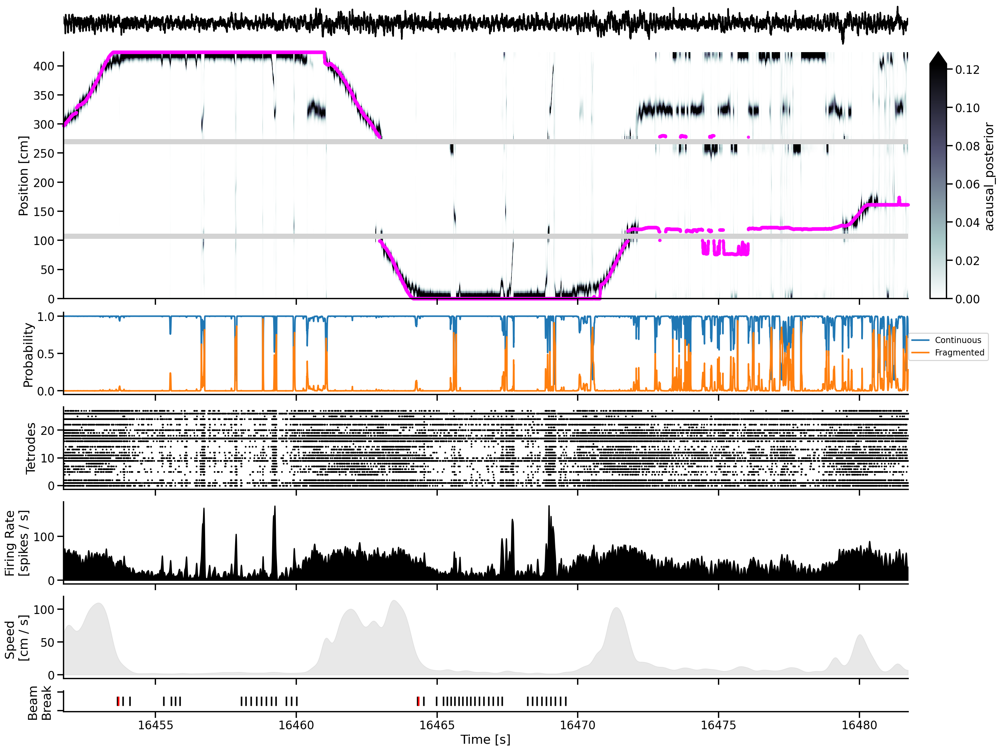

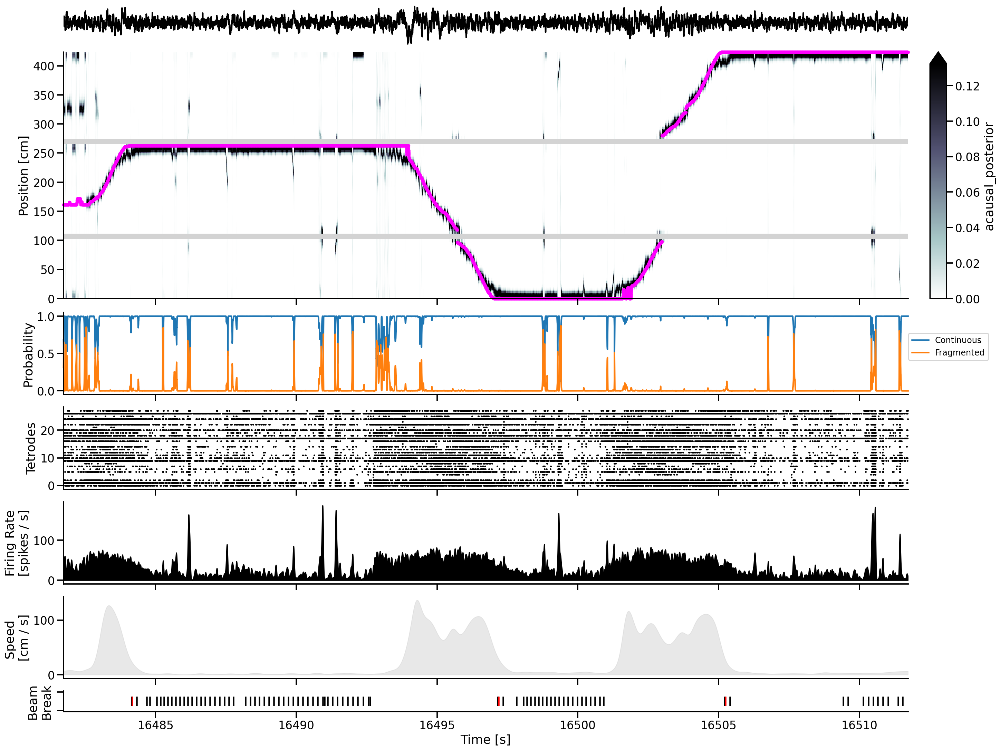

...

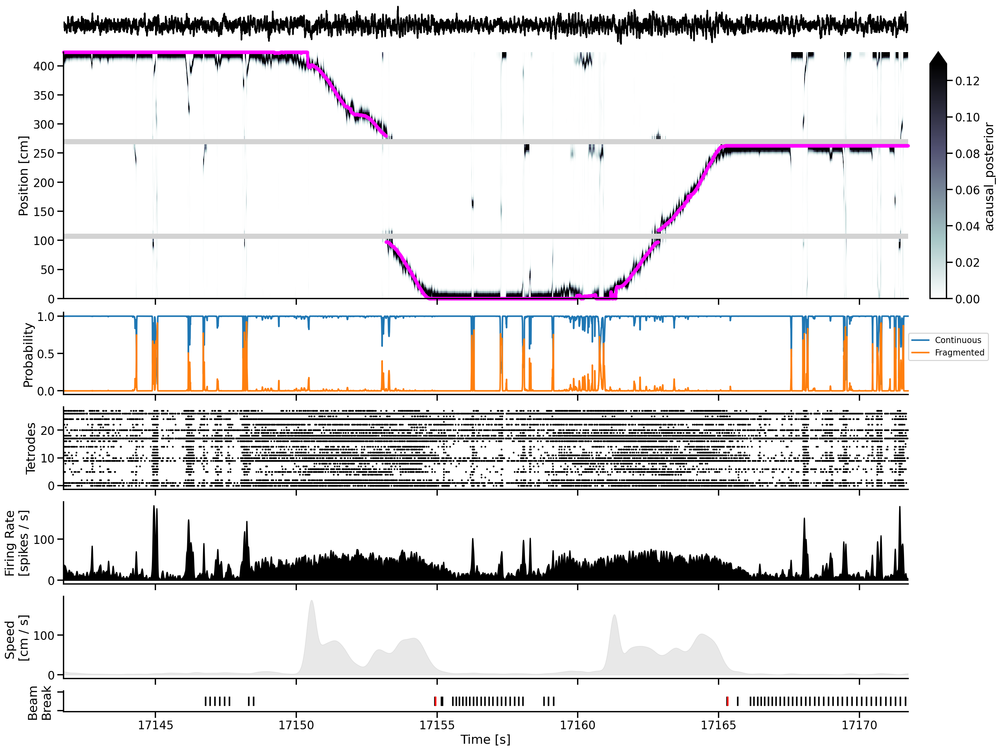

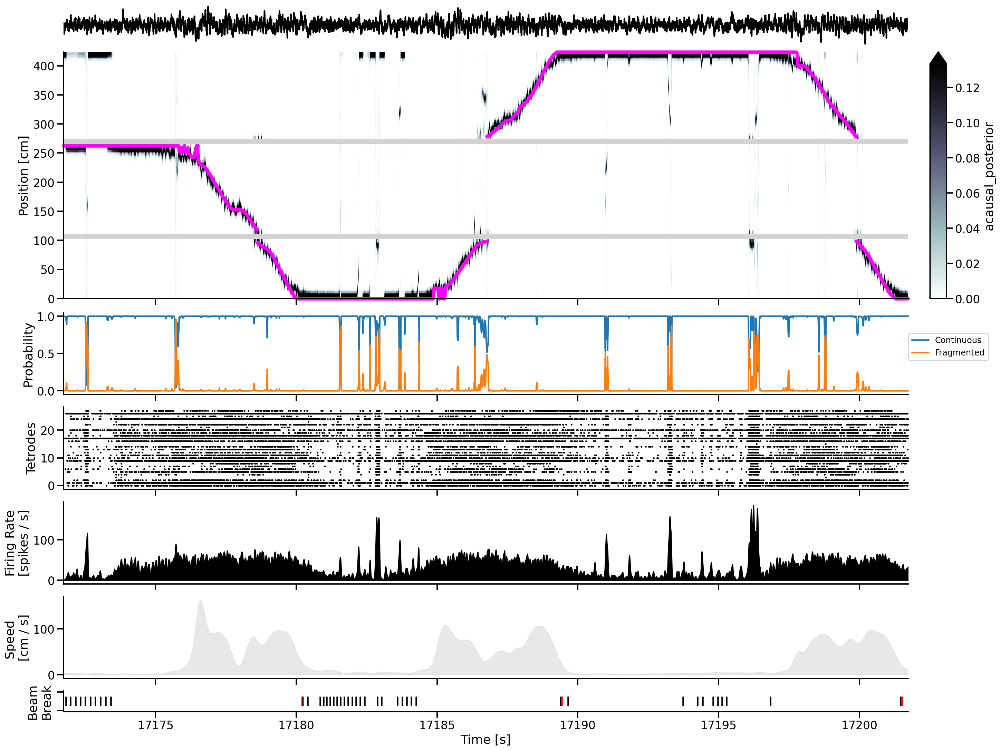

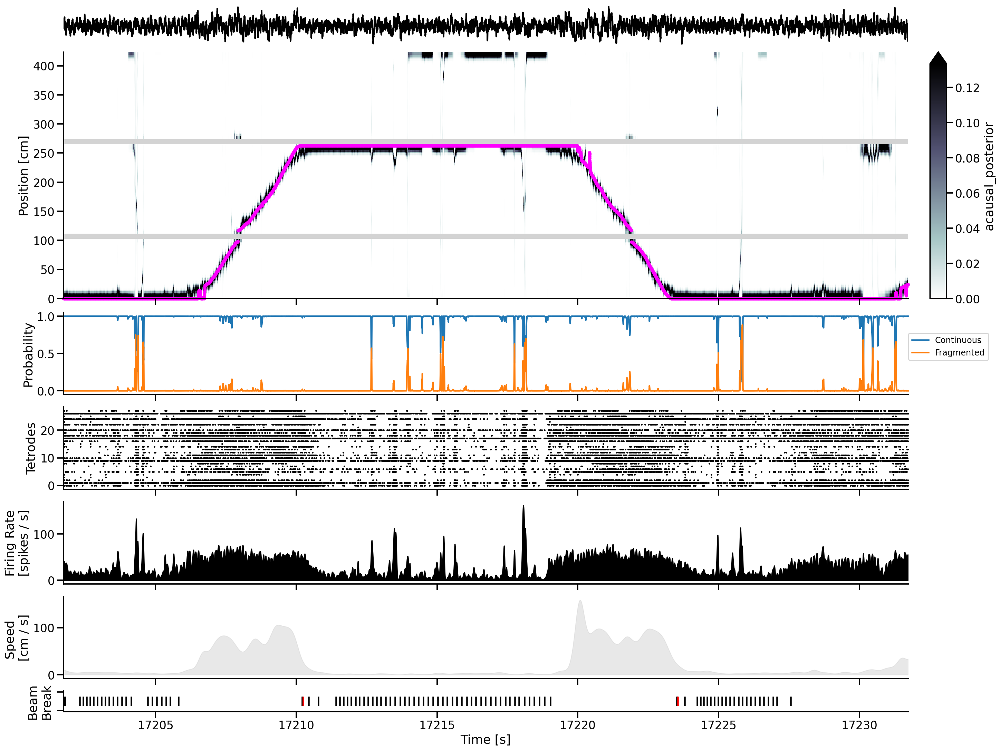

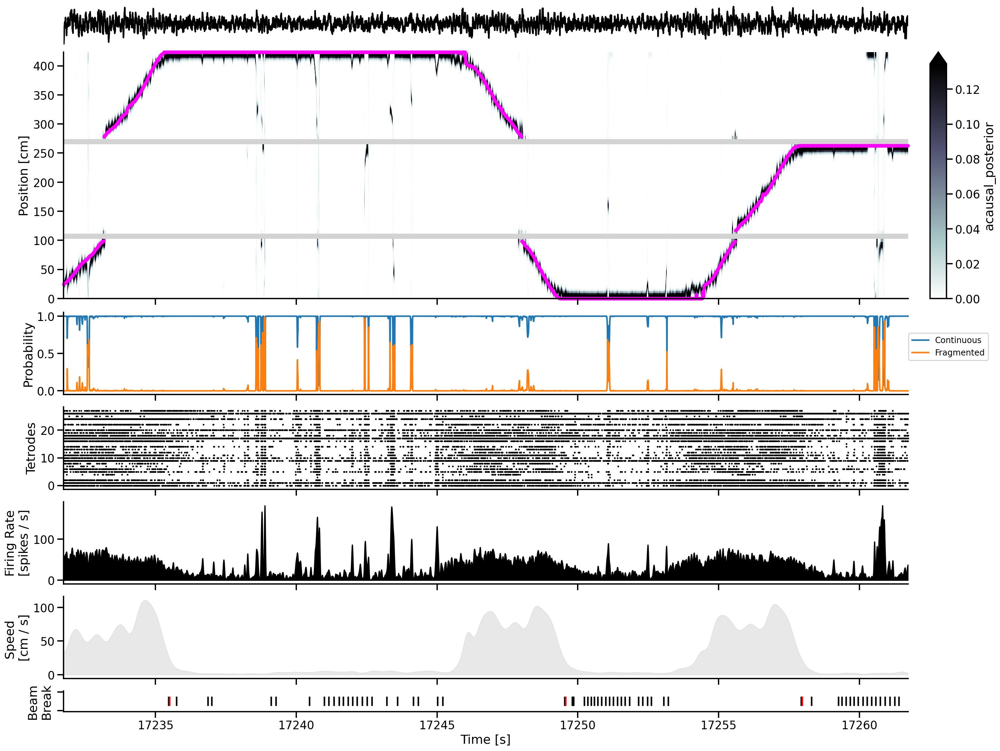

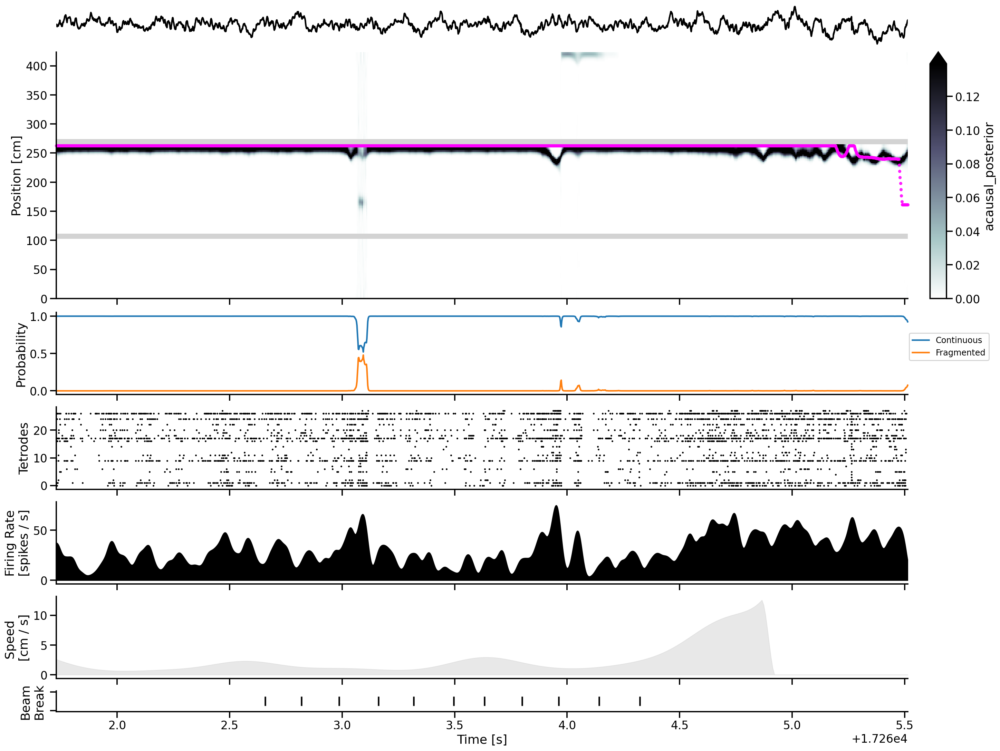

In [136]:
from src.visualization import plot_classifier_time_slice

n_time = results.time.shape[0]
time_slice_step = 15_000
time_range = zip(range(0, n_time, time_slice_step),
                 range(time_slice_step, n_time + time_slice_step,
                       time_slice_step))

for start_ind, end_ind in time_range:
    plot_classifier_time_slice(
        results.time[slice(start_ind, end_ind)],
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(20, 15),
    )

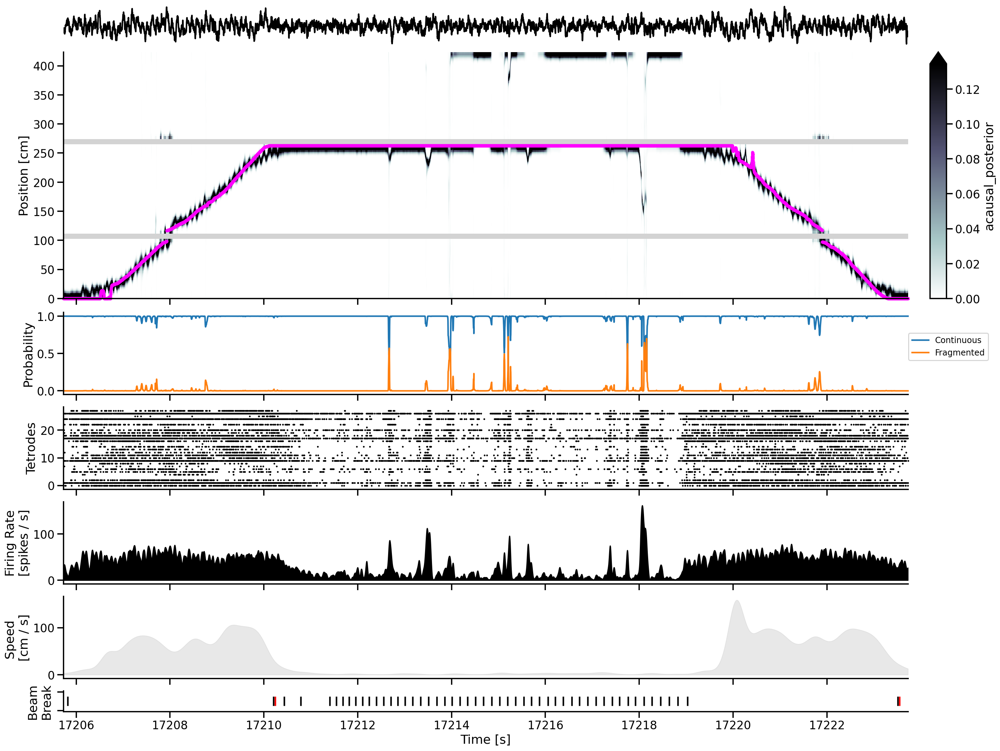

In [137]:
from src.visualization import plot_classifier_time_slice

plot_classifier_time_slice(
    results.time[slice(422_000, 431_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

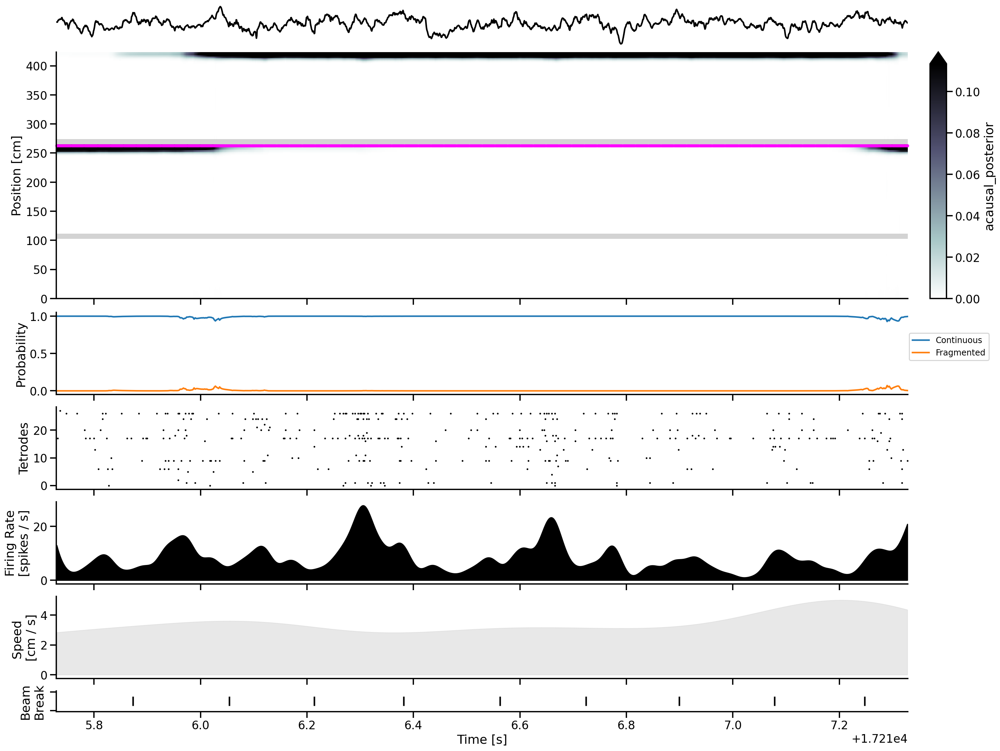

In [138]:
plot_classifier_time_slice(
    results.time[slice(427_000, 427_800)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

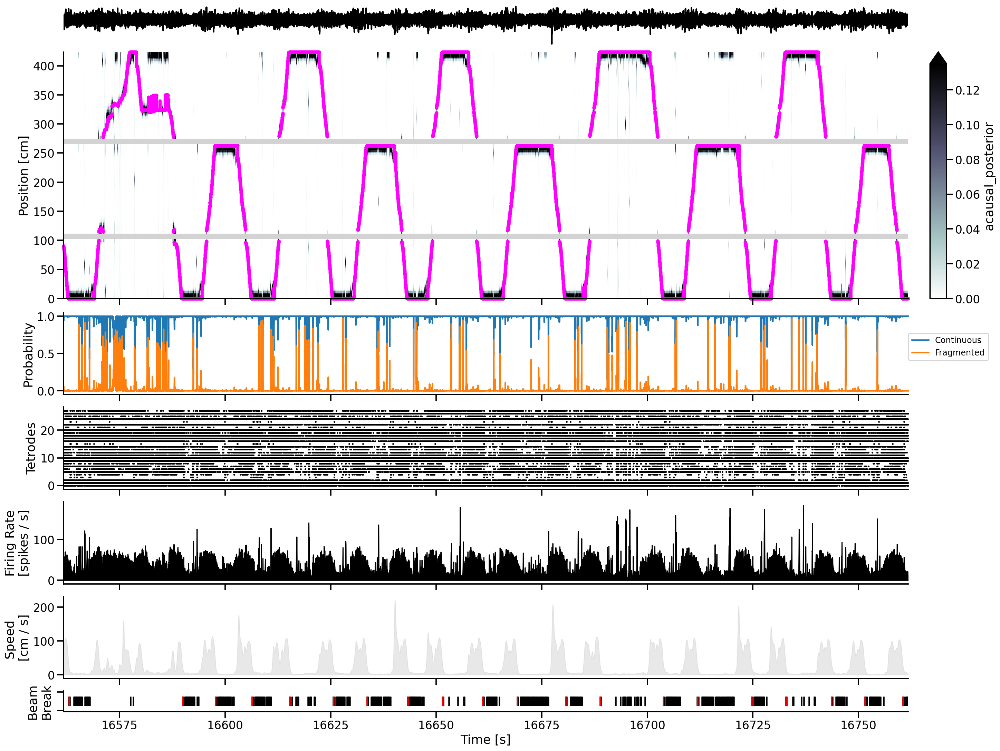

In [139]:
plot_classifier_time_slice(
    results.time[slice(100_000, 200_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

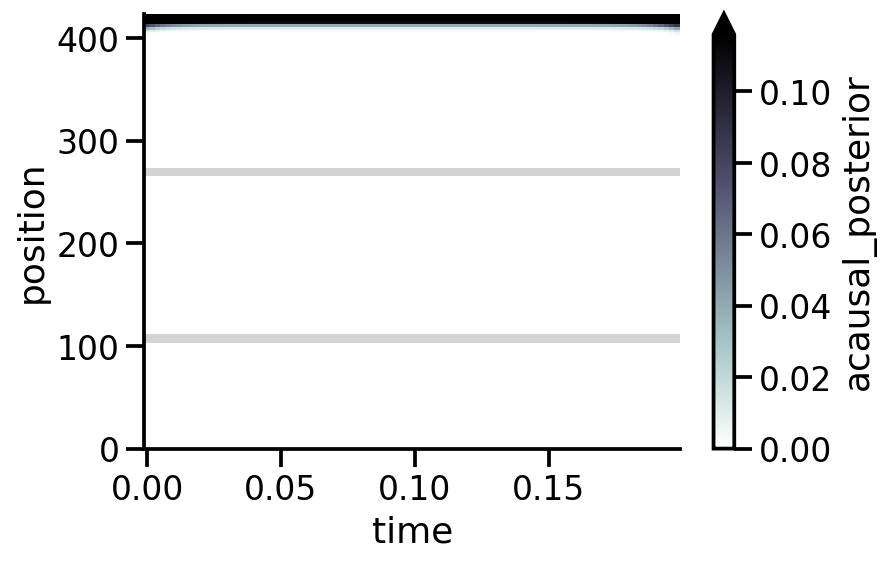

In [26]:
from src.parameters import SAMPLING_FREQUENCY
import copy

n_features, n_tetrodes = data['multiunits'].shape[1:]
n_time = 100

no_spike_results = (
    classifier.predict(
        np.full((n_time, n_features, n_tetrodes), np.nan),
        time=np.arange(n_time) / SAMPLING_FREQUENCY,
        state_names=state_names
    )
)

cmap = copy.copy(plt.get_cmap('bone_r'))
cmap.set_bad(color="lightgrey", alpha=1.0)

(no_spike_results
 .acausal_posterior
 .sum('state')
 .where(classifier.is_track_interior_)
 .plot(x='time', y='position', robust=True, vmin=0.0, cmap=cmap))
sns.despine()

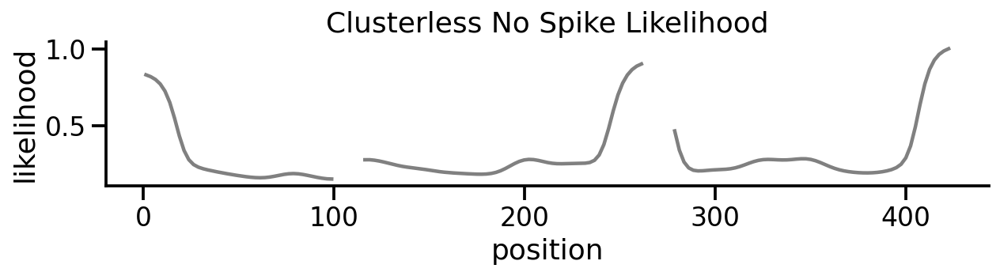

In [30]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5 / 3))
no_spike_results.likelihood.isel(time=0, state=0).plot(x='position', ax=ax, color='grey')
plt.title('Clusterless No Spike Likelihood')
sns.despine()

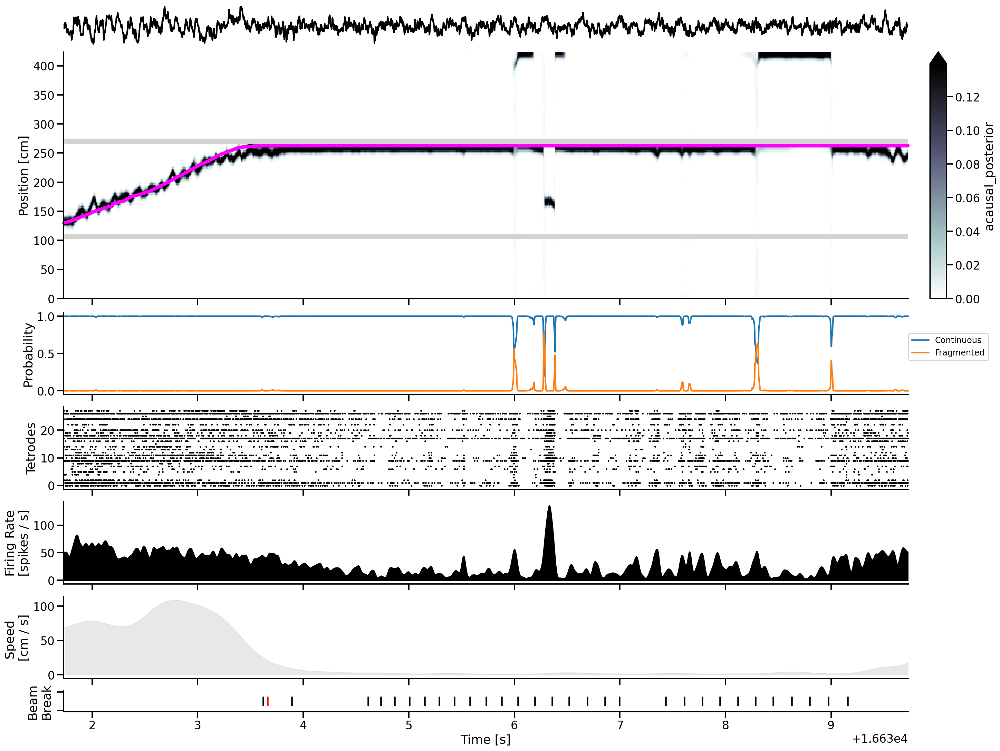

In [144]:
plot_classifier_time_slice(
    results.time[slice(135_000, 139_000)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

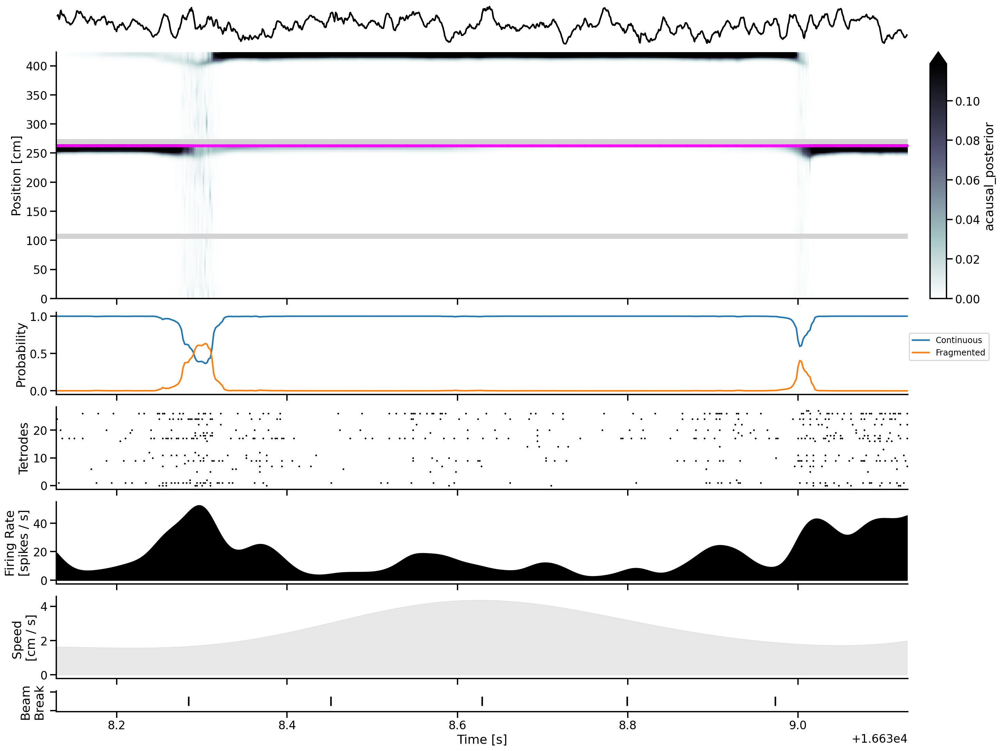

In [141]:
plot_classifier_time_slice(
    results.time[slice(138_200, 138_700)],
    classifier,
    results,
    data,
    posterior_type="acausal_posterior",
    figsize=(20, 15),
    legend=True,
)

24-May-21 14:07:50 Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
24-May-21 14:07:50 MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 3000x1500 -pix_fmt rgba -r 5.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y animation_clusterless.mp4


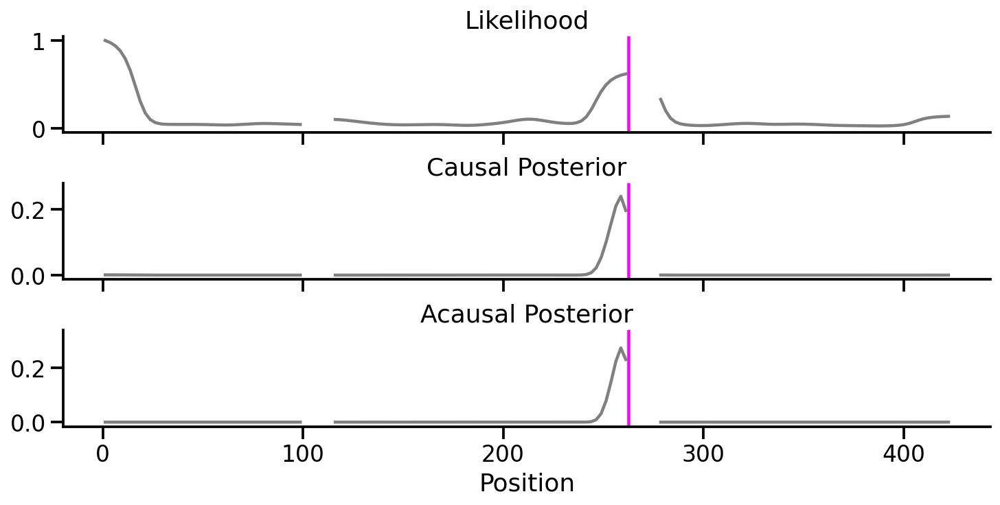

In [42]:
from celluloid import Camera
from IPython.display import HTML

time_slice = results.time[slice(138_200, 138_700)]

fig, axes = plt.subplots(3, 1, sharex=True, constrained_layout=True, figsize=(10, 5))
camera = Camera(fig)
t = data["position_info"].index / np.timedelta64(1, "s")
current_positions = (
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position)

for time, current_position in zip(results['likelihood'].sel(time=time_slice).time, current_positions):
    # ax 0
    (results['likelihood']
     .sel(time=time)
     .sel(state='Continuous')
     .where(classifier.is_track_interior_)
     .plot(x='position', ax=axes[0], color='grey'))
    axes[0].set_title('Likelihood')
    axes[0].set_xlabel('')
    axes[0].set_ylabel('')
    axes[0].axvline(current_position, color='magenta')
    
    # ax 1
    (results['causal_posterior']
     .sel(time=time)
     .sum('state')
     .where(classifier.is_track_interior_)
     .plot(x='position', ax=axes[1], color='grey'))
    axes[1].set_title('Causal Posterior')
    axes[1].set_xlabel('')
    axes[1].set_ylabel('')
    axes[1].axvline(current_position, color='magenta')
    
    # ax 2
    (results['acausal_posterior']
     .sel(time=time)
     .sum('state')
     .where(classifier.is_track_interior_)
     .plot(x='position', ax=axes[2], color='grey'))
    axes[2].set_title('Acausal Posterior')
    axes[2].set_xlabel('Position')
    axes[2].set_ylabel('')
    axes[2].axvline(current_position, color='magenta')
    
    sns.despine()
    camera.snap()
    

animation = camera.animate()
animation.save('animation_clusterless.mp4', dpi=300)

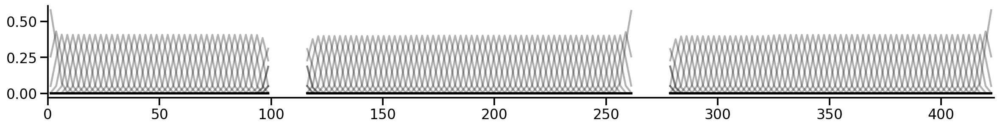

In [72]:
plt.figure(figsize=(20, 2))
for d in classifier.continuous_state_transition_[0, 0]:
    d[~classifier.is_track_interior_] = np.nan
    plt.plot(classifier.place_bin_centers_, d, color='black', alpha=0.3)

plt.xlim((classifier.place_bin_edges_[0], classifier.place_bin_edges_[-1]))
sns.despine()

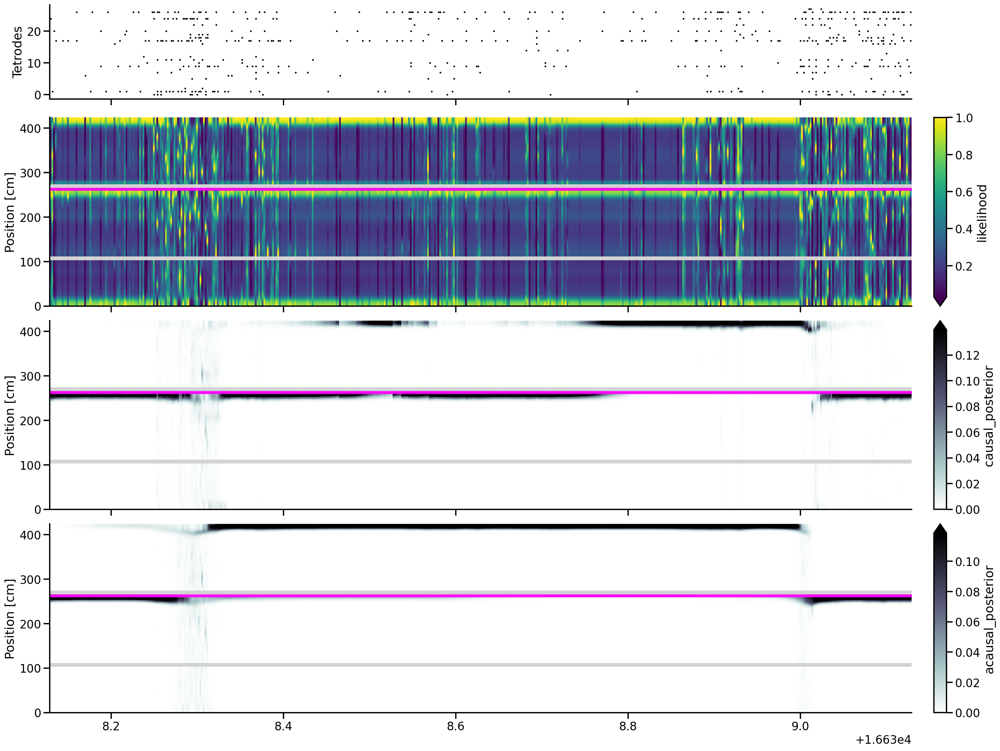

In [148]:
import pandas as pd
import copy

time_slice = results.time[slice(138_200, 138_700)]
figsize = (20, 15)

fig, axes = plt.subplots(
    4,
    1,
    figsize=figsize,
    sharex=True,
    constrained_layout=True,
    gridspec_kw={"height_ratios": [0.5, 1, 1, 1]},
)

t = data["position_info"].index / np.timedelta64(1, "s")

# ax 0

multiunit_spikes = pd.DataFrame(
    data['multiunit_spikes'],
    index=data['position_info'].index / np.timedelta64(1, "s")
).loc[time_slice]

spike_time_ind, tetrode_ind = np.nonzero(np.asarray(multiunit_spikes))
axes[0].scatter(multiunit_spikes.index[spike_time_ind], tetrode_ind, clip_on=False, s=1, color='black')
axes[0].set_ylabel("Tetrodes")


cmap = copy.copy(plt.get_cmap('viridis'))
cmap.set_bad(color="lightgrey", alpha=1.0)
    
# ax 1
(results['likelihood']
 .sel(state='Continuous')
 .where(classifier.is_track_interior_)
 .sel(time=time_slice)
 .plot(
    x="time", y="position", robust=True, ax=axes[1],
    cmap=cmap, vmax=1.0,
))

axes[1].set_ylabel("Position [cm]")

axes[1].scatter(
    data["position_info"].reset_index().set_index(t).loc[time_slice].index,
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position,
    color="magenta",
    alpha=0.8,
    s=10,
)
axes[1].set_xlabel("")
axes[1].set_title("")


cmap = copy.copy(plt.get_cmap('bone_r'))
cmap.set_bad(color="lightgrey", alpha=1.0)

# ax 2
(results['causal_posterior']
 .sum('state')
 .where(classifier.is_track_interior_)
 .sel(time=time_slice)
 .plot(
    x="time", y="position", robust=True, ax=axes[2],
    cmap=cmap, vmin=0.0,
))

axes[2].set_ylabel("Position [cm]")

axes[2].scatter(
    data["position_info"].reset_index().set_index(t).loc[time_slice].index,
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position,
    color="magenta",
    alpha=0.8,
    s=10,
)
axes[2].set_xlabel("")

# ax 3
(results['acausal_posterior']
 .sum('state')
 .where(classifier.is_track_interior_)
 .sel(time=time_slice)
 .plot(
    x="time", y="position", robust=True, ax=axes[3],
    cmap=cmap, vmin=0.0,
))

axes[3].set_ylabel("Position [cm]")

axes[3].scatter(
    data["position_info"].reset_index().set_index(t).loc[time_slice].index,
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position,
    color="magenta",
    alpha=0.8,
    s=10,
)
axes[3].set_xlabel("")
sns.despine()

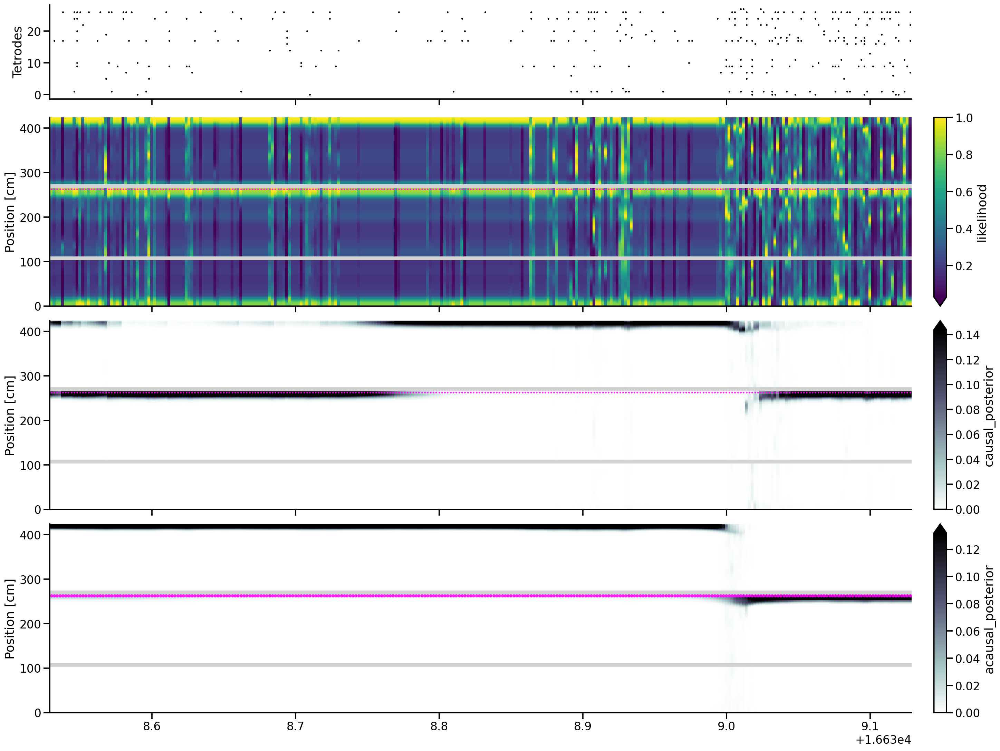

In [151]:
import pandas as pd
import copy

time_slice = results.time[slice(138_400, 138_700)]
figsize = (20, 15)

fig, axes = plt.subplots(
    4,
    1,
    figsize=figsize,
    sharex=True,
    constrained_layout=True,
    gridspec_kw={"height_ratios": [0.5, 1, 1, 1]},
)

t = data["position_info"].index / np.timedelta64(1, "s")

# ax 0

multiunit_spikes = pd.DataFrame(
    data['multiunit_spikes'],
    index=data['position_info'].index / np.timedelta64(1, "s")
).loc[time_slice]

spike_time_ind, tetrode_ind = np.nonzero(np.asarray(multiunit_spikes))
axes[0].scatter(multiunit_spikes.index[spike_time_ind], tetrode_ind, clip_on=False, s=1, color='black')
axes[0].set_ylabel("Tetrodes")


cmap = copy.copy(plt.get_cmap('viridis'))
cmap.set_bad(color="lightgrey", alpha=1.0)
    
# ax 1
(results['likelihood']
 .sel(state='Continuous')
 .where(classifier.is_track_interior_)
 .sel(time=time_slice)
 .plot(
    x="time", y="position", robust=True, ax=axes[1],
    cmap=cmap, vmax=1.0,
))

axes[1].set_ylabel("Position [cm]")

axes[1].scatter(
    data["position_info"].reset_index().set_index(t).loc[time_slice].index,
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position,
    color="magenta",
    alpha=0.8,
    s=1,
)
axes[1].set_xlabel("")
axes[1].set_title("")


cmap = copy.copy(plt.get_cmap('bone_r'))
cmap.set_bad(color="lightgrey", alpha=1.0)

# ax 2
(results['causal_posterior']
 .sum('state')
 .where(classifier.is_track_interior_)
 .sel(time=time_slice)
 .plot(
    x="time", y="position", robust=True, ax=axes[2],
    cmap=cmap, vmin=0.0,
))

axes[2].set_ylabel("Position [cm]")

axes[2].scatter(
    data["position_info"].reset_index().set_index(t).loc[time_slice].index,
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position,
    color="magenta",
    alpha=0.8,
    s=1,
)
axes[2].set_xlabel("")

# ax 3
(results['acausal_posterior']
 .sum('state')
 .where(classifier.is_track_interior_)
 .sel(time=time_slice)
 .plot(
    x="time", y="position", robust=True, ax=axes[3],
    cmap=cmap, vmin=0.0,
))

axes[3].set_ylabel("Position [cm]")

axes[3].scatter(
    data["position_info"].reset_index().set_index(t).loc[time_slice].index,
    data["position_info"]
    .reset_index()
    .set_index(t)
    .loc[time_slice]
    .linear_position,
    color="magenta",
    alpha=0.8,
    s=10,
)
axes[3].set_xlabel("")
sns.despine()